In [10]:
import numpy as np
import pandas as pd
import xarray as xr
import uxarray as ux

import dask as da
import dask.dataframe as dd
import multiprocessing as mp

import spatialpandas as sp
import spatialpandas.dask 

import holoviews as hv
from holoviews import opts
from holoviews.operation.datashader import rasterize
import geoviews as gv
import geoviews.feature as gf

import hvplot.pandas
import hvplot.xarray  
import hvplot.dask

from matplotlib import cm
import cartopy.crs as ccrs

In [11]:
import sys
%load_ext autoreload
%autoreload 2
sys.path.insert(1, '/glade/u/home/philipc/geocat-scratch/polymesh/polymesh')

from polymesh import polymesh as polymesh

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


# SCREAMv0 Data

In [12]:
ds_base_path = "/glade/scratch/ullrich/SCREAMv0/"

ds_grid = ux.open_dataset(ds_base_path + "meshCSne1024pg2.g",
                          ds_base_path + "SCREAMv0.SCREAM-DY2.ne1024pg2.20201127.eam.h0.2020-01-20-00000.TMQ.nc")

Loading initial grid from file:  /glade/scratch/ullrich/SCREAMv0/meshCSne1024pg2.g
Reading exodus file:  /glade/scratch/ullrich/SCREAMv0/meshCSne1024pg2.g
Finished reading exodus file.


# Mesh Construction

In [13]:
%%time
projection = ccrs.PlateCarree()
scream = polymesh(ds=ds_grid, projection=projection)

CPU times: user 54.4 s, sys: 4.36 s, total: 58.7 s
Wall time: 1min 1s


#  Visualization

In [33]:
hv.output(fig='svg', size=400)
cmap = cm.Blues

## Single Plot (Static)

CPU times: user 1.82 s, sys: 67.8 ms, total: 1.89 s
Wall time: 2.08 s


:DynamicMap   []
   :Overlay
      .Image.I     :Image   [x,y]   (x_y faces)
      .Coastline.I :Feature   [Longitude,Latitude]
      .Borders.I   :Feature   [Longitude,Latitude]
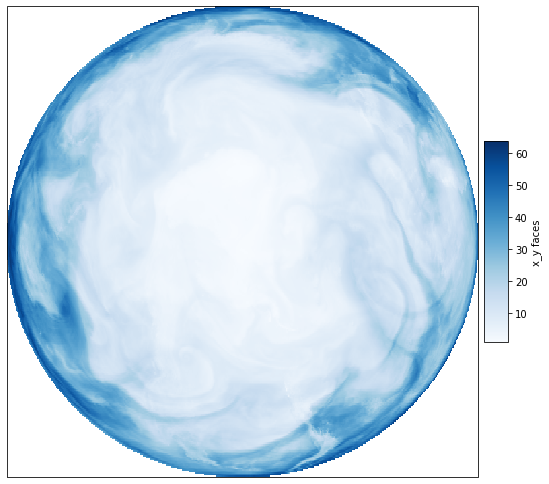

In [34]:
%%time
hvplot.extension('matplotlib')

# Select Data Variable
df = scream.data_mesh(name="TMQ", dims={"time" : 0}, fill='faces')

# Create a rasterized plot of our Polygons (Matplotlib Style)
TMQ_t0 = df.hvplot.polygons(rasterize=True,aggregator='mean', c='faces', cmap=cmap) * gf.coastline(projection=projection) * gf.borders(projection=projection)
TMQ_t0

# Export and Save Plot
#hv.save(out, "../plots/SCREAMv0.TMQ.T0", dpi=200)

## Single Plot (Interactive)

In [35]:
%%time
hvplot.extension('bokeh')

# Select Data Variable
df = scream.data_mesh(name="TMQ", dims={"time" : 0}, fill='faces')

# Create a rasterized plot of our Polygons (Matplotlib Style)
TMQ_t0 = df.hvplot.polygons(rasterize=True,aggregator='mean', c='faces', cmap=cmap) * gf.coastline(projection=projection) * gf.borders(projection=projection)
TMQ_t0


CPU times: user 1.8 s, sys: 70.9 ms, total: 1.87 s
Wall time: 2.07 s


:DynamicMap   []
   :Overlay
      .Image.I     :Image   [x,y]   (x_y faces)
      .Coastline.I :Feature   [Longitude,Latitude]
      .Borders.I   :Feature   [Longitude,Latitude]

# Multiple Plots

In [ ]:
%%time
hvplot.extension('matplotlib')

# Select Data Variable
df = scream.data_mesh(name="TMQ", dims={"time" : 0}, fill='faces')
TMQ_t0 = df.hvplot.polygons(rasterize=True,aggregator='mean', c='faces', cmap=cmap) * gf.coastline(projection=projection) * gf.borders(projection=projection)

df = scream.data_mesh(name="TMQ", dims={"time" : 1}, fill='faces')
TMQ_t1 = df.hvplot.polygons(rasterize=True,aggregator='mean', c='faces', cmap=cmap) * gf.coastline(projection=projection) * gf.borders(projection=projection)

df = scream.data_mesh(name="TMQ", dims={"time" : 2}, fill='faces')
TMQ_t2 = df.hvplot.polygons(rasterize=True,aggregator='mean', c='faces', cmap=cmap) * gf.coastline(projection=projection) * gf.borders(projection=projection)

TMQ_t0 + TMQ_t1 + TMQ_t2

CPU times: user 5.22 s, sys: 201 ms, total: 5.42 s
Wall time: 5.85 s
